In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.animation import PillowWriter
from mpl_toolkits import mplot3d
from IPython.display import Image

In [2]:
def label_to_works(label):
    if label == 1:
        return "Working", "Working"
    elif label == 2:
        return "Working", "Requesting"
    elif label == 3:
        return "Working", "Preparing"
    elif label == 4:
        return "Requesting", "Working"
    elif label == 5:
        return "Requesting", "Requesting"
    elif label == 6:
        return "Requesting", "Preparing"
    elif label == 7:
        return "Preparing", "Working"
    elif label == 8:
        return "Preparing", "Requesting"
    elif label == 9:
        return "Preparing", "Preparing"

In [3]:
def works_to_label(label_1, label_2):
    """
    1 : Working
    2 : Requesting
    3 : Preparing
    """
    if label_1==1 and label_2==1:
        return 1 # Working - Working
    elif label_1==1 and label_2==2:
        return 2 # Working - Requesting
    elif label_1==1 and label_2==3:
        return 3 # Working - Preparing
    elif label_1==2 and label_2==1:
        return 4 # Requesting - Working
    elif label_1==2 and label_2==2:
        return 5 # Requesting - Requesting
    elif label_1==2 and label_2==3:
        return 6 # Requesting - Preparing
    elif label_1==3 and label_2==1:
        return 7 # Preparing - Working
    elif label_1==3 and label_2==2:
        return 8 # Preparing - Requesting
    elif label_1==3 and label_2==3:
        return 9 # Preparing - Preparing

# Choose dataset

In [250]:
import pickle

# grouped
# with open("../data/skeleton/final/grouped/grouped_single_skeleton_dict_s01.pkl", "rb") as f:
#     skeleton_dict = pickle.load(f)

# grouped raw
# with open("../data/skeleton/all_joints/single_skeleton_all_joints_dict.pkl", "rb") as f:
#     skeleton_dict = pickle.load(f)

# paired raw
# with open("../data/skeleton/all_joints/paired_skeleton_all_joints_dict.pkl", "rb") as f:
#     skeleton_dict = pickle.load(f)

# with open("../data/skeleton/raw/paired_label_dict.pkl", "rb") as f:
#     label_dict = pickle.load(f)

# paired
with open("../data/skeleton/final/paired/paired_window_skeleton_dict.pkl", "rb") as f:
    skeleton_dict = pickle.load(f)

with open("../data/skeleton/final/paired/paired_window_label_dict.pkl", "rb") as f:
    label_dict = pickle.load(f)

In [251]:
for k in skeleton_dict.keys():
    print(k)

test_pairs_s1_s2_r1_p1_1_skeleton
test_pairs_s1_s2_r1_p1_2_skeleton
test_pairs_s1_s2_r1_p2_1_skeleton
test_pairs_s1_s2_r1_p2_2_skeleton
test_pairs_s1_s2_r2_p1_1_skeleton
test_pairs_s1_s2_r2_p1_2_skeleton
test_pairs_s1_s2_r2_p2_1_skeleton
test_pairs_s1_s2_r2_p2_2_skeleton
test_pairs_s1_s3_r1_p1_1_skeleton
test_pairs_s1_s3_r1_p1_2_skeleton
test_pairs_s1_s3_r1_p2_1_skeleton
test_pairs_s1_s3_r2_p1_1_skeleton
test_pairs_s1_s3_r2_p1_2_skeleton
test_pairs_s1_s3_r2_p2_2_skeleton
test_pairs_s3_s2_r1_p1_1_skeleton
test_pairs_s3_s2_r1_p1_2_skeleton
test_pairs_s3_s2_r1_p2_1_skeleton
test_pairs_s3_s2_r1_p2_2_skeleton
test_pairs_s3_s2_r2_p1_1_skeleton
test_pairs_s3_s2_r2_p1_2_skeleton
test_pairs_s3_s2_r2_p2_1_skeleton
test_pairs_s3_s2_r2_p2_2_skeleton


In [ ]:
skeleton_file = "s01_a01_t01_r03_skeleton"
skeletons = np.array(skeleton_dict[skeleton_file])
skeletons.shape

In [252]:
# choose one file
# skeleton_file = "s01_s02_a01_a01_t01_t01_r01_r01_skeleton"
# label = works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]])
# skeletons = np.array(skeleton_dict[skeleton_file])

# paired
skeleton_file = "test_pairs_s3_s2_r1_p2_1_skeleton"
skeletons = np.array(skeleton_dict[skeleton_file])
label_file = "test_pairs_s3_s2_r1_p2_1_label"
labels = np.array(label_dict[label_file])

In [191]:
# split raw paired skeleton
min_len = min(len(skeletons), len(labels))
skeletons = skeletons[:min_len]
labels = labels[:min_len]

plus_sk = []
plus_lb = []
minus_sk = []
minus_lb = []

for i in range(min_len):
    if skeletons[i][0].sum() >= 0:
        plus_sk.append(skeletons[i])
        plus_lb.append(labels[i])
    else:
        minus_sk.append(skeletons[i])
        minus_lb.append(labels[i])

plus_sk = np.array(plus_sk)
plus_lb = np.array(plus_lb)
minus_sk = np.array(minus_sk)
minus_lb = np.array(minus_lb)

new_skeleton = []

for i in set(plus_lb):
    min_len = min(len(np.where(plus_lb==i)[0]), len(np.where(minus_lb==i)[0]))
    concat = np.concatenate((minus_sk[np.where(minus_lb==i)][:min_len], plus_sk[np.where(plus_lb==i)][:min_len]), axis=-1)
    print(concat.shape)
    new_skeleton.append(concat)
print(np.array(new_skeleton).shape)

(152, 3, 64)
(82, 3, 64)
(190, 3, 64)
(140, 3, 64)
(129, 3, 64)
(104, 3, 64)
(167, 3, 64)
(88, 3, 64)
(143, 3, 64)
(9,)


In [192]:
set(minus_lb)

{1, 2, 3, 4, 5, 6, 7, 8, 9}

# Plot Image

In [18]:
# Creating 3D figure
def plot_skeleton(skeleton, label, norm=True):
    fig = plt.figure(figsize = (8,8))
    ax = plt.axes(projection='3d')

    mins, maxs = skeleton.min(axis=1), skeleton.max(axis=1)

    num_sk = 10 if norm else 32
    for i in range(num_sk):
        ax.scatter(skeleton[0][i], skeleton[2][i], skeleton[1][i], c='r')
    
    if norm:    
        connections = [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]
    else:
        connections = [[0,1], [1,2], [2,3], [2,4], [4,5], [5,6], [6,7], [7,8], [8,9], [7,10], [2,11], [11,12], [12,13], [13,14], [14,15], [15,16], [14,17], [0,18], [18,19], [19,20], [20,21], [0,22], [22,23], [23,24], [24,25], [3,26], [26,27], [26, 28], [26,29], [26,30], [26,31]]

    for i, j in connections:
        ax.plot([skeleton[0][i], skeleton[0][j]], [skeleton[2][i], skeleton[2][j]], [skeleton[1][i], skeleton[1][j]], c='r')
    
    ax.set_xlabel("x")
    ax.set_ylabel("z")
    ax.set_zlabel("y")
    # check
    ax.set_xlim([mins[0], maxs[0]])
    ax.set_ylim([mins[2], maxs[2]])
    ax.set_zlim([mins[1], maxs[1]])
    ax.invert_zaxis()
    plt.title(label)
    
    plt.show()

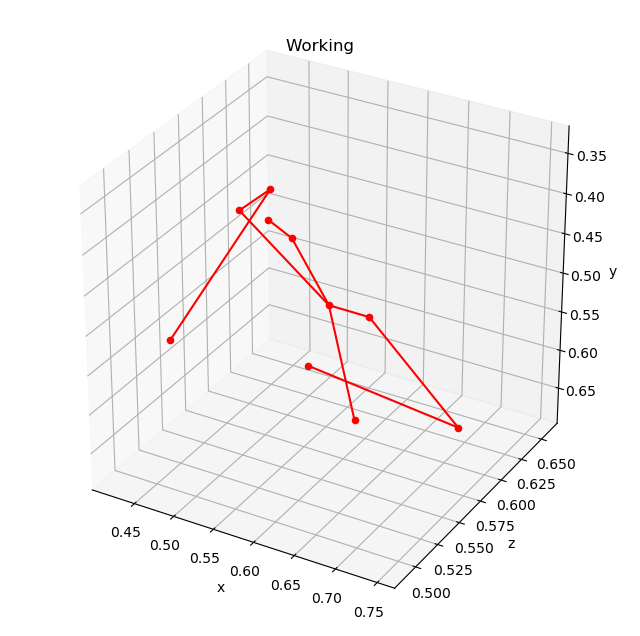

In [31]:
plot_skeleton(skeletons[11][129][:, :10], label_to_works(label)[0])
# plot_skeleton(skeletons[100], 'Working', norm=False)

# Plot animation of one skeleoton

In [44]:
def animate_skeleton(skeletons, label, norm=True):

    mins, maxs = skeletons.min(axis=2).min(axis=0), skeletons.max(axis=2).max(axis=0)

    def update(frame):
        ax.clear()
        ax.set_xlabel("x")
        ax.set_ylabel("z")
        ax.set_zlabel("y")
        ax.set_xlim([mins[0], maxs[0]])
        ax.set_ylim([mins[2], maxs[2]])
        ax.set_zlim([mins[1], maxs[1]])
        ax.invert_zaxis()
        ax.set_title(label)
        
        num_sk = 10 if norm else 32

        for i in range(num_sk):
            ax.scatter(skeletons[frame][0][i], skeletons[frame][2][i], skeletons[frame][1][i], c='r')

        if norm:
            connections = [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]
        else:
            connections = [[0,1], [1,2], [2,3], [2,4], [4,5], [5,6], [6,7], [7,8], [8,9], [7,10], [2,11], [11,12], [12,13], [13,14], [14,15], [15,16], [14,17], [0,18], [18,19], [19,20], [20,21], [0,22], [22,23], [23,24], [24,25], [3,26], [26,27], [26, 28], [26,29], [26,30], [26,31]]

        for i, j in connections:
            ax.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                    [skeletons[frame][2][i], skeletons[frame][2][j]], 
                    [skeletons[frame][1][i], skeletons[frame][1][j]], c='r')

    # Set up the figure and axes
    fig = plt.figure(figsize=(5.5, 5.5))
    ax = fig.add_subplot(111, projection='3d')

    # Set the number of frames
    num_frames = skeletons.shape[0]

    # Create the animation
    ani = FuncAnimation(fig, update, frames=num_frames, interval=100)
    plt.close(fig)

    # Save gif
    writer = PillowWriter(fps=30)
    ani.save("./gif/raw/single/working/working_2.gif", writer=writer)

    # display gif
    return Image(open('./gif/raw/single/working/working_2.gif', 'rb').read())

In [45]:
skeleton_file = "s01_a01_t01_r06_skeleton"
skeletons = np.array(skeleton_dict[skeleton_file])
skeletons.shape

(197, 3, 32)

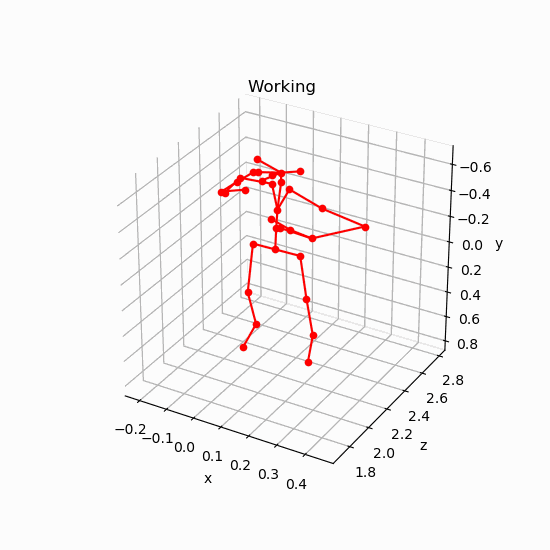

In [46]:
# animate_skeleton(skeletons[-1][:, :, :10], label_to_works(label)[0])
animate_skeleton(skeletons, 'Working', norm=False)

# Plot animation of two skeletons

In [270]:
def animate_skeletons(skeletons, label, subplot=True, norm=False):

    mins, maxs = skeletons.min(axis=2).min(axis=0), skeletons.max(axis=2).max(axis=0)
    
    num_sk = 10 if norm else 32

    if norm:    
        connections = [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]
    else:
        connections = [[0,1], [1,2], [2,3], [2,4], [4,5], [5,6], [6,7], [7,8], [8,9], [7,10], [2,11], [11,12], [12,13], [13,14], [14,15], [15,16], [14,17], [0,18], [18,19], [19,20], [20,21], [0,22], [22,23], [23,24], [24,25], [3,26], [26,27], [26, 28], [26,29], [26,30], [26,31]]

    def update(frame):
        ax.clear()
        ax.set_xlabel("x")
        ax.set_ylabel("z")
        ax.set_zlabel("y")
        ax.set_xlim([mins[0], maxs[0]])
        ax.set_ylim([mins[2], maxs[2]])
        ax.set_zlim([mins[1], maxs[1]])
        ax.invert_zaxis()
        if subplot:
            ax2.clear()
            ax2.set_xlabel("x")
            ax2.set_ylabel("z")
            ax2.set_zlabel("y")
            ax.set_xlim([mins[0], maxs[0]])
            ax.set_ylim([mins[2], maxs[2]])
            ax.set_zlim([mins[1], maxs[1]])
            ax2.invert_zaxis()
            ax.set_title(label1)
            ax2.set_title(label2)
        else:
            ax.set_title(label)
        
        for i in range(num_sk):
            ax.scatter(skeletons[frame][0][i], skeletons[frame][2][i], skeletons[frame][1][i], c='r')

            if subplot:
                ax2.scatter(skeletons[frame][0][i+num_sk], skeletons[frame][2][i+num_sk], skeletons[frame][1][i+num_sk], c='b')
            else:
                ax.scatter(skeletons[frame][0][i+num_sk], skeletons[frame][2][i+num_sk], skeletons[frame][1][i+num_sk], c='b')

        for i, j in connections:
            ax.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                    [skeletons[frame][2][i], skeletons[frame][2][j]], 
                    [skeletons[frame][1][i], skeletons[frame][1][j]], 'r')
            
        for i, j in connections:
            i += num_sk
            j += num_sk
            
            if subplot:
                ax2.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                        [skeletons[frame][2][i], skeletons[frame][2][j]], 
                        [skeletons[frame][1][i], skeletons[frame][1][j]], 'b')
            else:
                ax.plot([skeletons[frame][0][i], skeletons[frame][0][j]], 
                        [skeletons[frame][2][i], skeletons[frame][2][j]], 
                        [skeletons[frame][1][i], skeletons[frame][1][j]], 'b')

    # Set up the figure and axes
    if subplot:
        fig = plt.figure(figsize=(8, 5.5))
        ax = fig.add_subplot(121, projection='3d')
        ax2 = fig.add_subplot(122, projection='3d')
        label1, label2 = label
    else:
        fig = plt.figure(figsize=(5.5, 5.5))
        ax = fig.add_subplot(111, projection='3d')
        label = " (red) - ".join(label) + " (blue)"
    
    # Set the number of frames
    num_frames = skeletons.shape[0]

    # Create the animation
    ani = FuncAnimation(fig, update, frames=num_frames, interval=100)
    plt.close(fig)
    global num
    # Save gif
    writer = PillowWriter(fps=30)
    ani.save(f"./gif/norm/paired/{num}/{num}_0.gif", writer=writer)

    # display gif
    return Image(open(f'./gif/norm/paired/{num}/{num}_0.gif', 'rb').read())

In [273]:
# animate_skeletons(skeletons[1], label_to_works(label), subplot=False, norm=True)
# animate_skeletons(np.array(new_skeleton[8]), ("Preparing", "Preparing"), subplot=False, norm=False)
for num in [5,6,7,8,9]:
    animate_skeletons(skeletons[np.where(labels==num)][-1], label_to_works(num), subplot=False, norm=True)

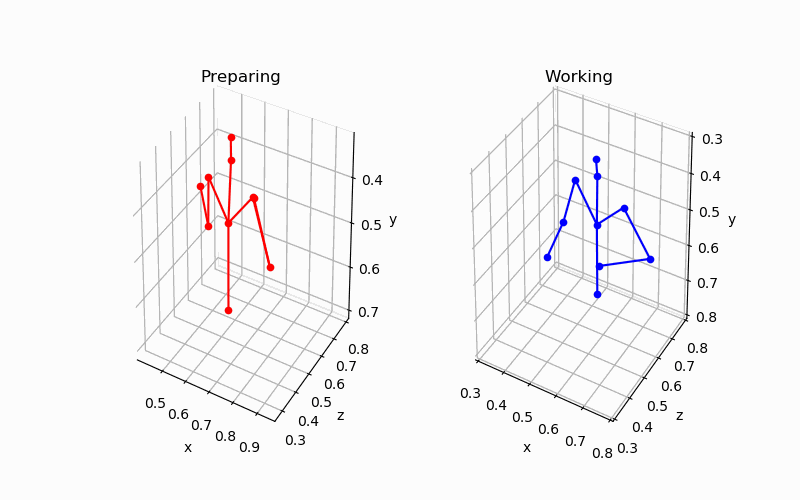

In [149]:
# without overlapping
animate_skeletons(skeletons[1], label_to_works(label), subplot=True)

# Show all animations of works(working, requesting, preparing)

In [96]:
# working skeleton
# skeleton_file = "s01_s11_a01_a02_12_skeleton"
skeleton_file = "s09_a01_t01_r01_skeleton"
label1 = label_to_works(works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]]))[0]
skeleton1 = np.array(skeleton_dict[skeleton_file])#[0][:, :, :10]

# requesting skeleton
# skeleton_file = "s01_s11_a02_a02_12_skeleton"
skeleton_file = "s09_a02_t01_r01_skeleton"
label2 = label_to_works(works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]]))[0]
skeleton2 = np.array(skeleton_dict[skeleton_file])#[0][:, :, :10]

# preparing skeleton
# skeleton_file = "s01_s11_a03_a02_12_skeleton"
skeleton_file = "s09_a03_t01_r01_skeleton"
label3 = label_to_works(works_to_label(*[int(i[-1]) for i in skeleton_file.split("_")[2:4]]))[0]
skeleton3 = np.array(skeleton_dict[skeleton_file])#[0][:, :, :10]

In [98]:
def animate_three_skeletons(skeletons, labels, norm=False):
    print(skeletons.shape)
    
    mins, maxs = skeletons.min(axis=-1).min(axis=1), skeletons.max(axis=-1).max(axis=1)

    num_sk = 10 if norm else 32
    if norm:
        connections = [[0,1], [1,2], [1,3], [3,4], [4,5], [1,6], [6,7], [7,8], [2,9]]
    else:
        connections = [[0,1], [1,2], [2,3], [2,4], [4,5], [5,6], [6,7], [7,8], [8,9], [7,10], [2,11], [11,12], [12,13], [13,14], [14,15], [15,16], [14,17], [0,18], [18,19], [19,20], [20,21], [0,22], [22,23], [23,24], [24,25], [3,26], [26,27], [26, 28], [26,29], [26,30], [26,31]]

    def update(frame):
        for i in range(3):
            if i == 0:
                ax = ax1
                label = labels[0]
                skeleton = skeletons[0]
            elif i == 1:
                ax = ax2
                label = labels[1]
                skeleton = skeletons[1]
            elif i == 2:
                ax = ax3
                label = labels[2]
                skeleton = skeletons[2]

            ax.clear()
            ax.set_xlabel("x")
            ax.set_ylabel("z")
            ax.set_zlabel("y")
            ax.set_xlim([mins[i][0], maxs[i][0]])
            ax.set_ylim([mins[i][2], maxs[i][2]])
            ax.set_zlim([mins[i][1], maxs[i][1]])
            ax.invert_zaxis()
            ax.set_title(label)
            
            for i in range(num_sk):
                ax.scatter(skeleton[frame][0][i], skeleton[frame][2][i], skeleton[frame][1][i], c='r')

            for i, j in connections:
                ax.plot([skeleton[frame][0][i], skeleton[frame][0][j]], 
                        [skeleton[frame][2][i], skeleton[frame][2][j]], 
                        [skeleton[frame][1][i], skeleton[frame][1][j]], c='r')

    # Set up the figure and axes
    fig = plt.figure(figsize=(9, 5.5))
    ax1 = fig.add_subplot(131, projection='3d')
    ax2 = fig.add_subplot(132, projection='3d')
    ax3 = fig.add_subplot(133, projection='3d')

    # Set the number of frames
    num_frames = skeletons[0].shape[0]

    # Create the animation
    ani = FuncAnimation(fig, update, frames=num_frames, interval=100)
    plt.close(fig)

    # Save gif
    writer = PillowWriter(fps=30)
    ani.save("./gif/raw/single/all/all_0.gif", writer=writer)

    # display gif
    return Image(open('./gif/raw/single/all/all_0.gif', 'rb').read())

(3, 195, 3, 32)


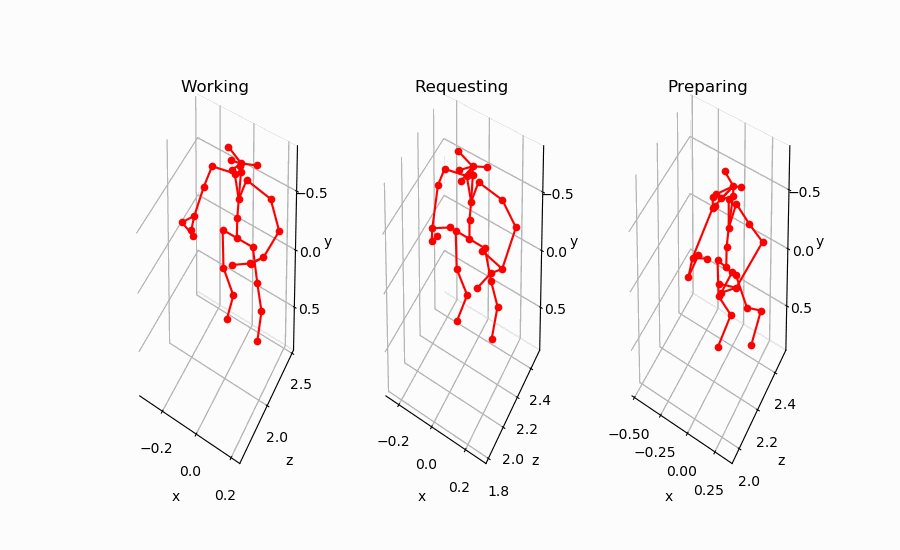

In [99]:
# animate_three_skeletons(np.array([skeleton1, skeleton2, skeleton3]), [label1, label2, label3])

# three raw skeletons
min_window_length = min(skeleton1.shape[0], skeleton2.shape[0], skeleton3.shape[0])
animate_three_skeletons(np.array([skeleton1[:min_window_length, :, :], skeleton2[:min_window_length, :, :], skeleton3[:min_window_length, :, :]]), ['Working', 'Requesting', 'Preparing'])